# PokéGAN

![Pokémon Logo](https://upload.wikimedia.org/wikipedia/commons/thumb/9/98/International_Pok%C3%A9mon_logo.svg/1200px-International_Pok%C3%A9mon_logo.svg.png)

We'll try to generate new pokemons from the 809 pokemons. Here, we'll use the DCGAN. Let's see if we can generate them successfully! 🤞🤞

In [1]:
import os
import matplotlib.pyplot as plt
import numpy as np
import cv2

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision

from tqdm import tqdm
import warnings
warnings.simplefilter('ignore')

%matplotlib inline

print(f'''NumPy: {np.__version__}
PyTorch: {torch.__version__}''')

NumPy: 1.21.6
PyTorch: 1.11.0


In [2]:
DATA_DIR = '../input/pokemon-images-dataset/pokemon_jpg/pokemon_jpg/'

print(f'# of Images in DATA_DIR: {len(os.listdir(DATA_DIR))}')

# of Images in DATA_DIR: 819


## Source Images
Let's see what we're dealing with.

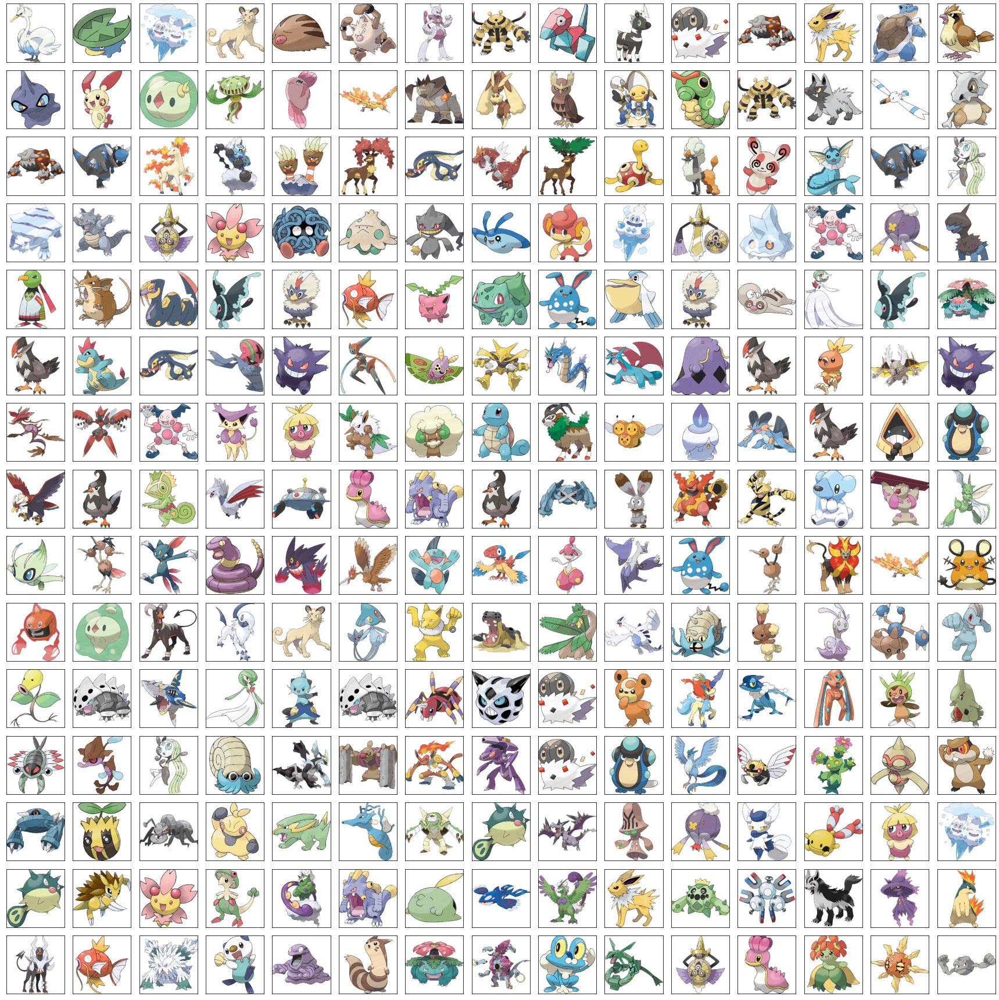

In [3]:
fig, axes = plt.subplots(15, 15, figsize=(24, 24))

for ax in axes.flatten():
    idx = np.random.choice(range(809))
    pokemon_name = os.listdir(DATA_DIR)[idx]
    img_path = DATA_DIR + pokemon_name
    img = cv2.imread(img_path, cv2.IMREAD_COLOR)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax.imshow(img)
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.show()

Man!!! That's Nostalgic 😂 (MewTwo I Choose You!!!). Sadly, I don't recognize a lot of them. Probably because I stopped watching Pokémon after Johto I guess.

## Adversarial Network
Now, to the techical part, we'll build the DCGAN here.

![DCGAN](https://miro.medium.com/max/846/1*rdXKdyfNjorzP10ZA3yNmQ.png)

### Architecture guidline for stable Deep Convolution GANs
1. Replace any pooling layers with strided convolutions (discriminators) and fractional-strided convolutions (generator).
2. Use batchnorm in both the generator and the discriminator
3. Remove fully connected hidden layers for deeper architectures
4. Use ReLU activation in generator for all layers except the output which uses Tanh.
5. Use LeakyReLU activation in the discriminator for all layers.



### Discriminator

In [4]:
class Discriminator(nn.Module):
    def __init__(self, img_channels, features_d):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            # 3x256x256
            self._block(in_channels=img_channels, out_channels=features_d, kernel_size=4, stride=2, padding=1, bn=False), # fdx128x128
            self._block(in_channels=features_d, out_channels=features_d*2, kernel_size=4, stride=2, padding=1, bn=True), # 64x64
            self._block(in_channels=features_d*2, out_channels=features_d*4, kernel_size=4, stride=2, padding=1, bn=True), # 32x32
            self._block(in_channels=features_d*4, out_channels=features_d*8, kernel_size=4, stride=2, padding=1, bn=True), #16x16
            self._block(in_channels=features_d*8, out_channels=features_d*16, kernel_size=4, stride=2, padding=1, bn=True), #8x8
            self._block(in_channels=features_d*16, out_channels=features_d*32, kernel_size=4, stride=2, padding=1, bn=True), # 4x4
            nn.Conv2d(in_channels=features_d*32, out_channels=1, kernel_size=4, stride=2, padding=0) # 1x1
        )
        
    def _block(self, in_channels, out_channels, kernel_size, stride, padding, bn=True):
        if bn:
            return nn.Sequential(
                nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding),
                nn.BatchNorm2d(num_features=out_channels),
                nn.LeakyReLU(0.1)
            )
        return nn.Sequential(
                nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding),
                nn.LeakyReLU(0.1)
            )
    
    def forward(self, x):
        return self.disc(x)

### Generator

In [5]:
class Generator(nn.Module):
    def __init__(self, z_dim, img_channels, features_g):
        super(Generator, self).__init__()
        self.gen = nn.Sequential(
            self._block(in_channels=z_dim, out_channels=features_g*64, kernel_size=4, stride=2, padding=0, bn=False), # 1x1
            self._block(in_channels=features_g*64, out_channels=features_g*32, kernel_size=4, stride=2, padding=1, bn=True), # 4x4
            self._block(in_channels=features_g*32, out_channels=features_g*16, kernel_size=4, stride=2, padding=1, bn=True), # 8x8
            self._block(in_channels=features_g*16, out_channels=features_g*8, kernel_size=4, stride=2, padding=1, bn=True), # 16x16
            self._block(in_channels=features_g*8, out_channels=features_g*4, kernel_size=4, stride=2, padding=1, bn=True), #32x32
            self._block(in_channels=features_g*4, out_channels=features_g*2, kernel_size=4, stride=2, padding=1, bn=True), # 64x64
#             self._block(in_channels=features_g*2, out_channels=features_g, kernel_size=4, stride=2, padding=1, bn=True), #128x128
            nn.ConvTranspose2d(in_channels=features_g*2, out_channels=img_channels, kernel_size=4, stride=2, padding=1), # 256x256
            nn.Tanh()
        )
        
    def _block(self, in_channels, out_channels, kernel_size, stride, padding, bn=True):
        if bn:
            return nn.Sequential(
                nn.ConvTranspose2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding),
                nn.BatchNorm2d(num_features=out_channels),
                nn.ReLU(0.1)
            )
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding),
            nn.ReLU(0.1)
        )
    
    def forward(self, x):
        return self.gen(x)

### Initializing weights

In [6]:
def initialize_weights(model):
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)

In [7]:
def test():
    """Extracted from: https://github.com/aladdinpersson/Machine-Learning-Collection/blob/master/ML/Pytorch/GANs/2.%20DCGAN/model.py"""
    N, in_channels, H, W = 8, 3, 256, 256
    noise_dim = 100
    x = torch.randn((N, in_channels, H, W))
    disc = Discriminator(in_channels, 8)
    print(f'Discriminator Shape: {disc(x).shape}')
    assert disc(x).shape == (N, 1, 1, 1), "Discriminator test failed"
    gen = Generator(noise_dim, in_channels, 8)
    z = torch.randn((N, noise_dim, 1, 1))
    print(f'Generator Shape: {gen(z).shape}')
    assert gen(z).shape == (N, in_channels, H, W), "Generator test failed"
    print("Success!")

test()

Discriminator Shape: torch.Size([8, 1, 1, 1])
Generator Shape: torch.Size([8, 3, 256, 256])
Success!


### Training

#### Loaders

In [8]:
class PokemonDataset(torch.utils.data.Dataset):
    def __init__(self, img_path):
        super(PokemonDataset, self).__init__()
        self.img_path = img_path
        print(f'IMG_PATH: {self.img_path}')
    
    def __len__(self):
        return len(os.listdir(self.img_path))
    
    def __getitem__(self, idx):
        pth = os.listdir(self.img_path)[idx]
#         print(pth)
        img = cv2.imread(self.img_path + pth, cv2.IMREAD_COLOR)
        cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = torch.tensor(img)
        img = img.permute(2, 0, 1)
        return img/255.0, 1

#### Hyperparams

In [9]:
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
LEARNING_RATE = 2e-4
BETA = (0.5, 0.999)
BATCH_SIZE = 16
IMAGE_SIZE = 256
IMG_CHANNELS = 3
Z_DIM = 100
FEATURES_DISC = 64
FEATURES_GEN = 64
NUM_EPOCHS = 100

print(f'DEVICE: {DEVICE}')

DEVICE: cuda


In [10]:
gen = Generator(z_dim=Z_DIM, img_channels=IMG_CHANNELS, features_g=FEATURES_GEN).to(DEVICE)
disc = Discriminator(img_channels=IMG_CHANNELS, features_d=FEATURES_DISC).to(DEVICE)

initialize_weights(gen)
initialize_weights(disc)

test()

Discriminator Shape: torch.Size([8, 1, 1, 1])
Generator Shape: torch.Size([8, 3, 256, 256])
Success!


In [11]:
opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=BETA)
opt_disc = optim.Adam(disc.parameters(), lr=LEARNING_RATE, betas=BETA)
criterion = nn.BCEWithLogitsLoss()
fixed_noise = torch.randn((36, Z_DIM, 1, 1)).to(DEVICE)

In [12]:
dataset = PokemonDataset(img_path=DATA_DIR)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)

IMG_PATH: ../input/pokemon-images-dataset/pokemon_jpg/pokemon_jpg/


						***** EPOCH [1/100] *****


100%|██████████| 52/52 [00:42<00:00,  1.22it/s]


Discriminant Loss: 0.004 Generator Loss: 0.007


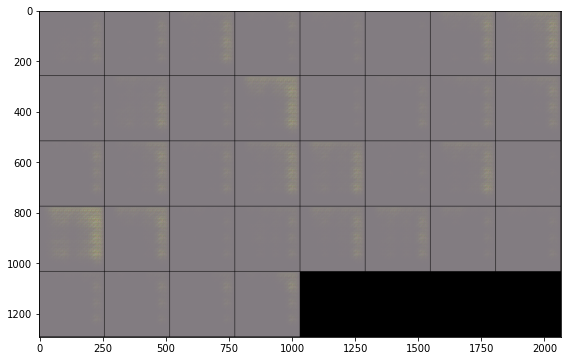



						***** EPOCH [2/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.000 Generator Loss: 0.009


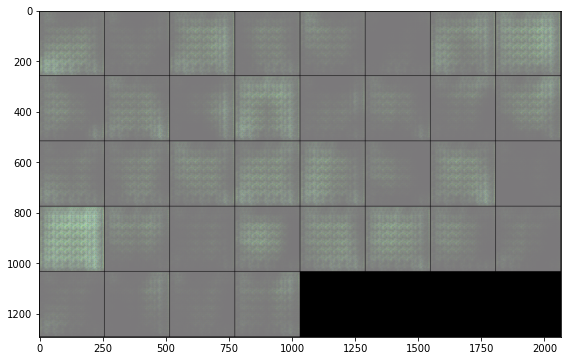



						***** EPOCH [3/100] *****


100%|██████████| 52/52 [00:33<00:00,  1.58it/s]


Discriminant Loss: 0.000 Generator Loss: 0.009


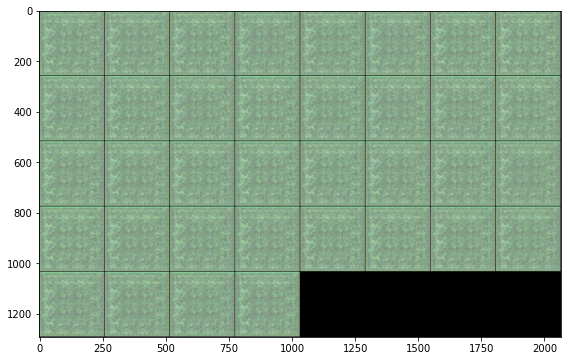



						***** EPOCH [4/100] *****


100%|██████████| 52/52 [00:33<00:00,  1.57it/s]


Discriminant Loss: 0.000 Generator Loss: 0.010


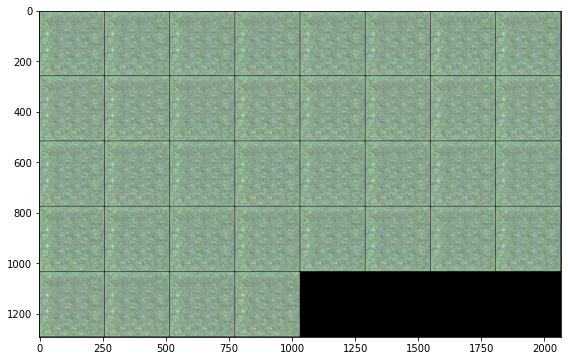



						***** EPOCH [5/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.014 Generator Loss: 0.001


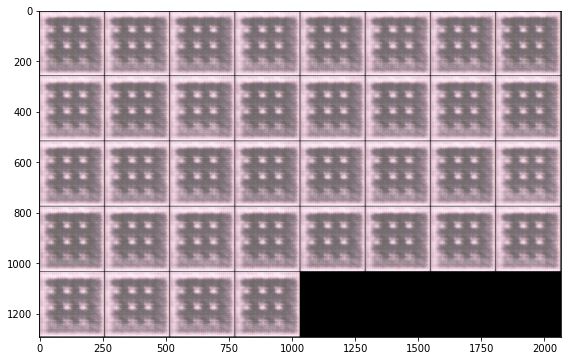



						***** EPOCH [6/100] *****


100%|██████████| 52/52 [00:33<00:00,  1.57it/s]


Discriminant Loss: 0.038 Generator Loss: 0.003


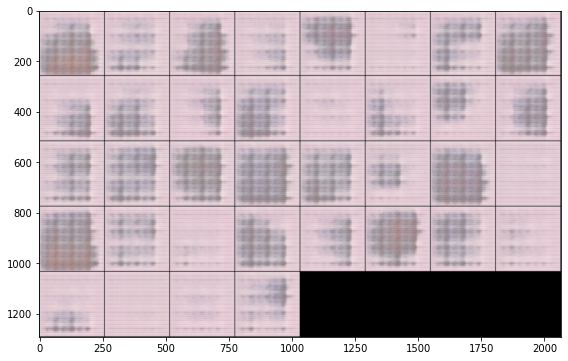



						***** EPOCH [7/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.036 Generator Loss: 0.002


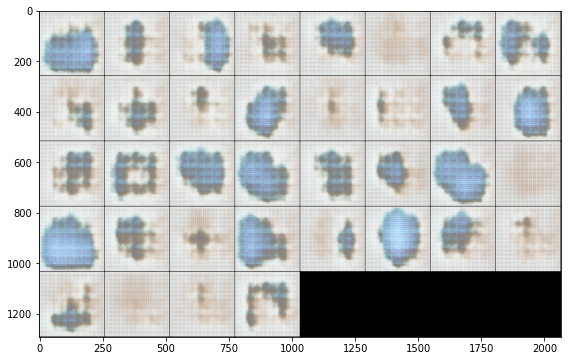



						***** EPOCH [8/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.036 Generator Loss: 0.001


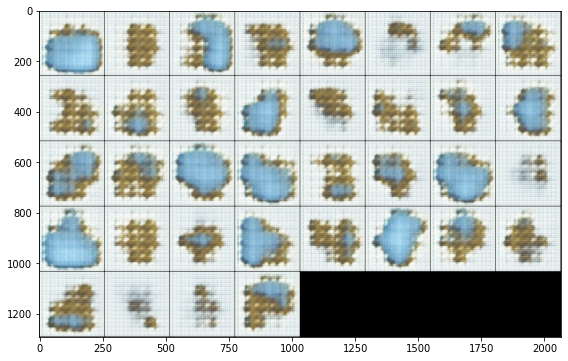



						***** EPOCH [9/100] *****


100%|██████████| 52/52 [00:33<00:00,  1.57it/s]


Discriminant Loss: 0.038 Generator Loss: 0.002


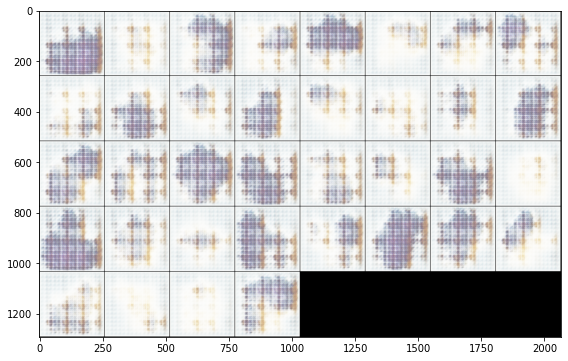



						***** EPOCH [10/100] *****


100%|██████████| 52/52 [00:33<00:00,  1.57it/s]


Discriminant Loss: 0.035 Generator Loss: 0.001


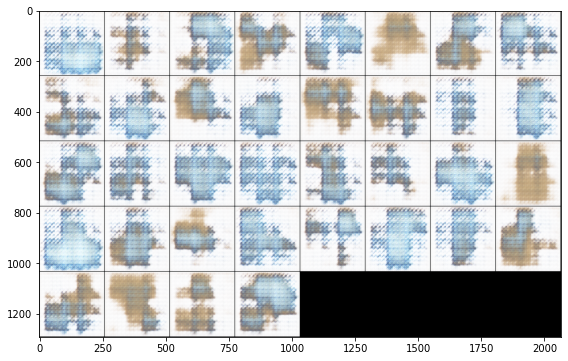



						***** EPOCH [11/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.031 Generator Loss: 0.002


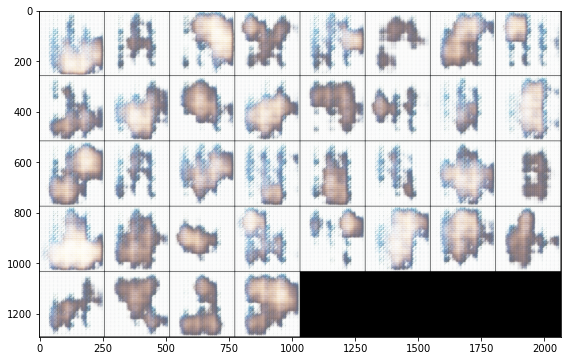



						***** EPOCH [12/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.029 Generator Loss: 0.001


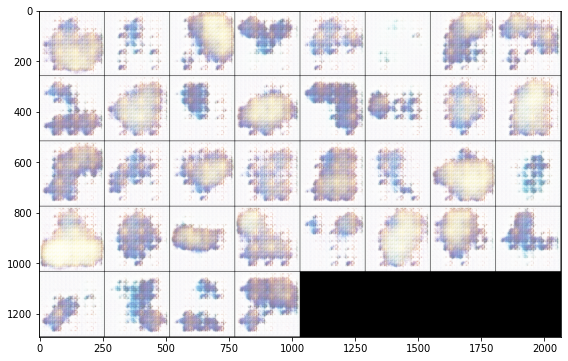



						***** EPOCH [13/100] *****


100%|██████████| 52/52 [00:33<00:00,  1.57it/s]


Discriminant Loss: 0.036 Generator Loss: 0.002


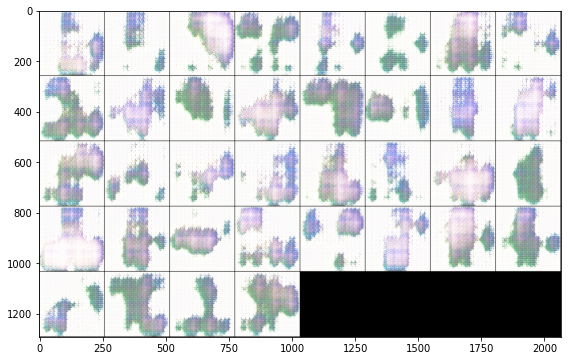



						***** EPOCH [14/100] *****


100%|██████████| 52/52 [00:33<00:00,  1.57it/s]


Discriminant Loss: 0.035 Generator Loss: 0.001


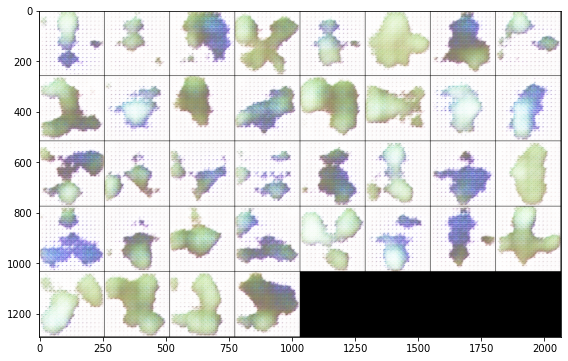



						***** EPOCH [15/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.034 Generator Loss: 0.002


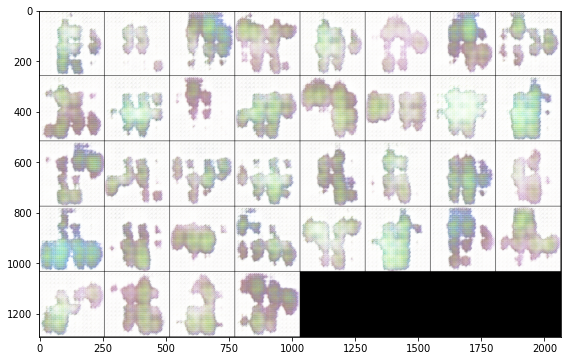



						***** EPOCH [16/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.034 Generator Loss: 0.003


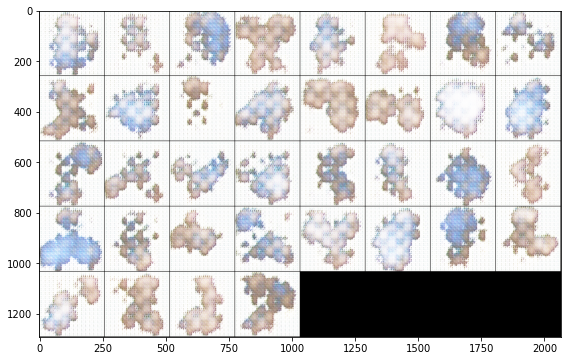



						***** EPOCH [17/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.031 Generator Loss: 0.004


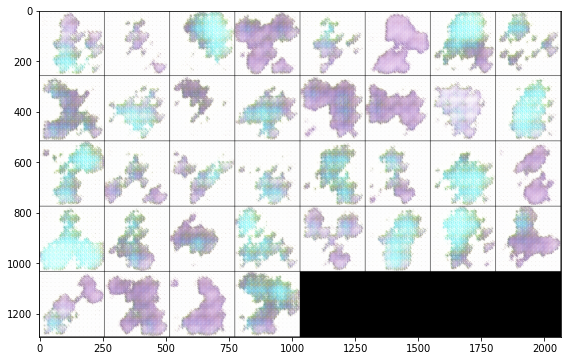



						***** EPOCH [18/100] *****


100%|██████████| 52/52 [00:33<00:00,  1.58it/s]


Discriminant Loss: 0.033 Generator Loss: 0.002


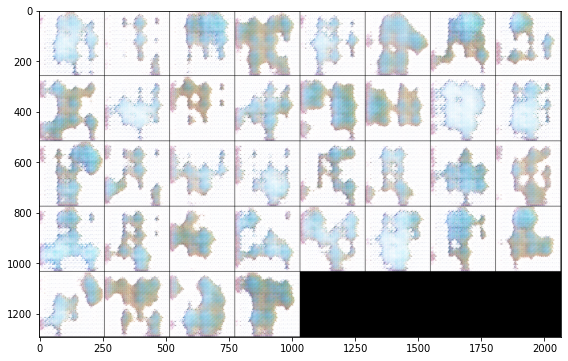



						***** EPOCH [19/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.031 Generator Loss: 0.002


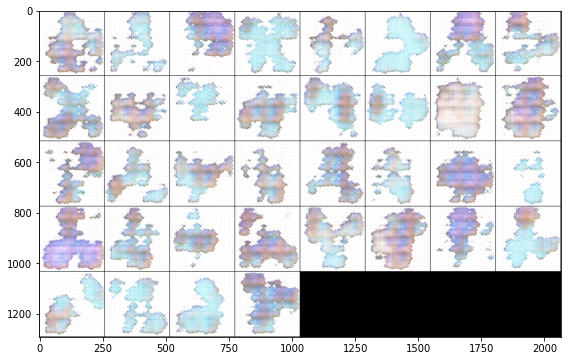



						***** EPOCH [20/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.032 Generator Loss: 0.002


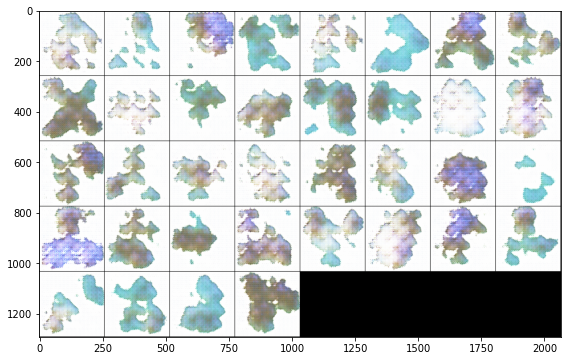



						***** EPOCH [21/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.029 Generator Loss: 0.003


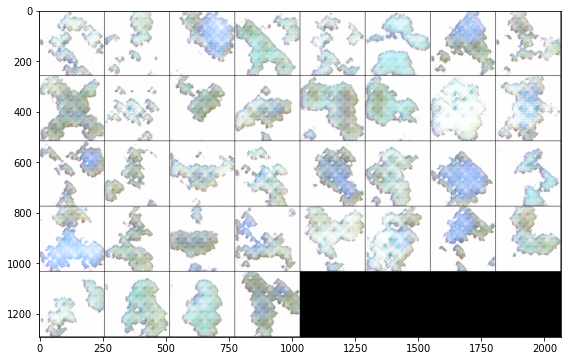



						***** EPOCH [22/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.027 Generator Loss: 0.004


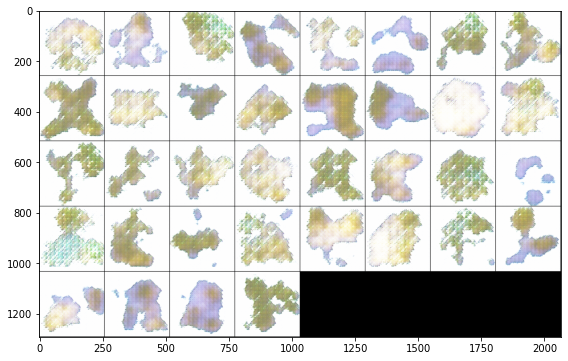



						***** EPOCH [23/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.023 Generator Loss: 0.004


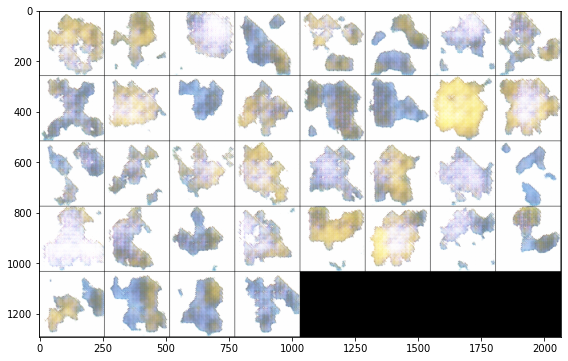



						***** EPOCH [24/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.023 Generator Loss: 0.004


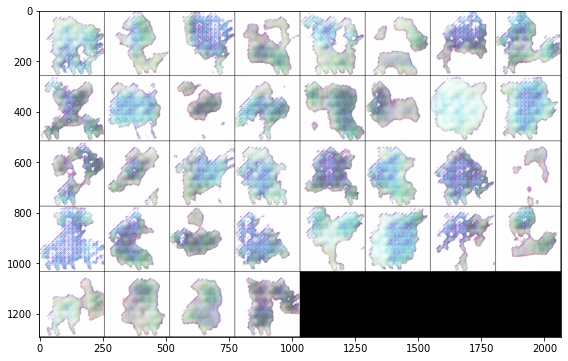



						***** EPOCH [25/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.020 Generator Loss: 0.005


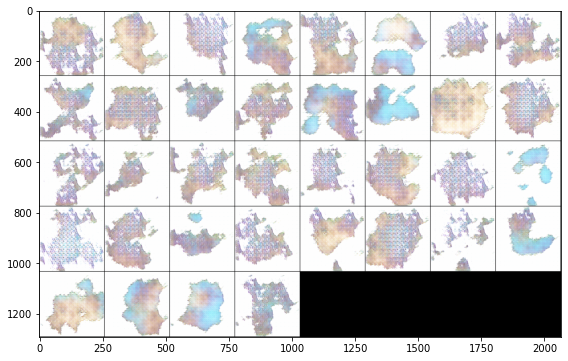



						***** EPOCH [26/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.022 Generator Loss: 0.003


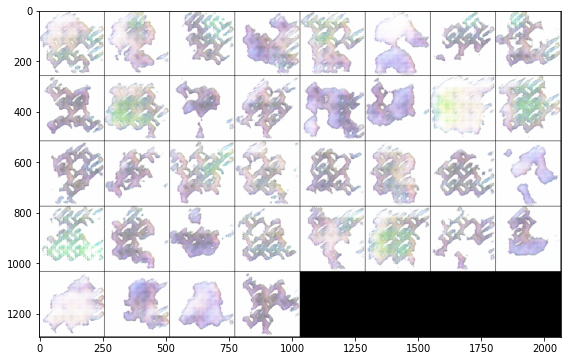



						***** EPOCH [27/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.018 Generator Loss: 0.001


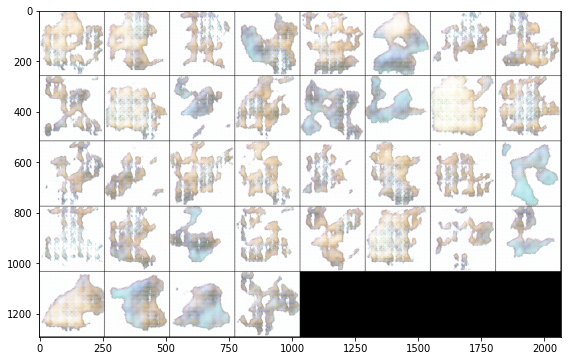



						***** EPOCH [28/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.022 Generator Loss: 0.001


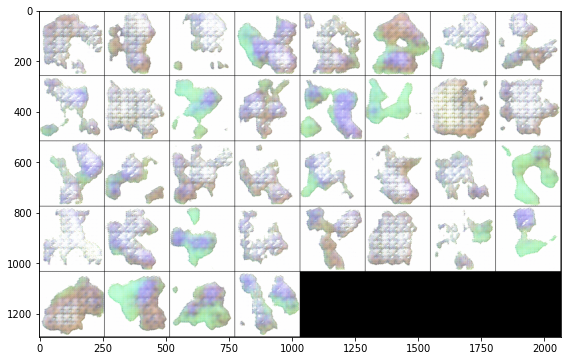



						***** EPOCH [29/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.016 Generator Loss: 0.008


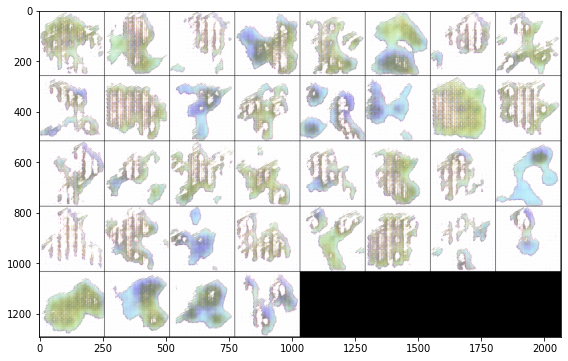



						***** EPOCH [30/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.014 Generator Loss: 0.000


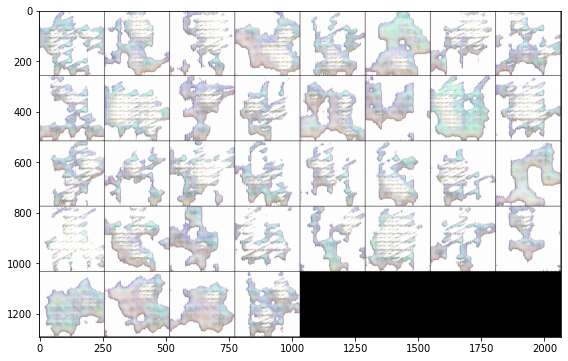



						***** EPOCH [31/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.016 Generator Loss: 0.006


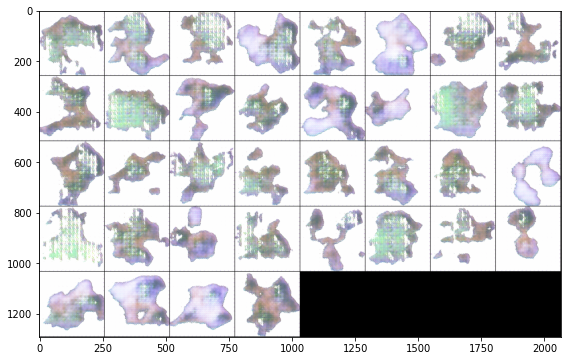



						***** EPOCH [32/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.013 Generator Loss: 0.004


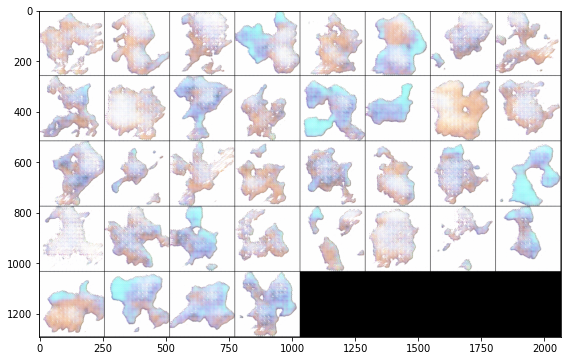



						***** EPOCH [33/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.011 Generator Loss: 0.005


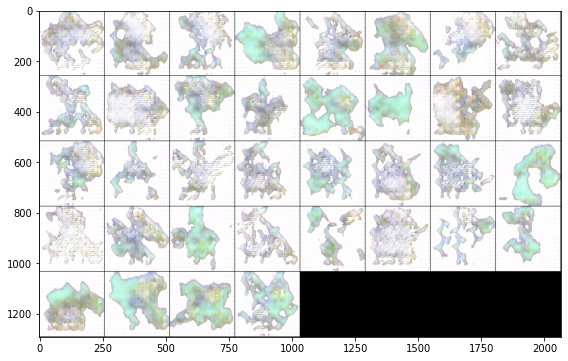



						***** EPOCH [34/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.003 Generator Loss: 0.007


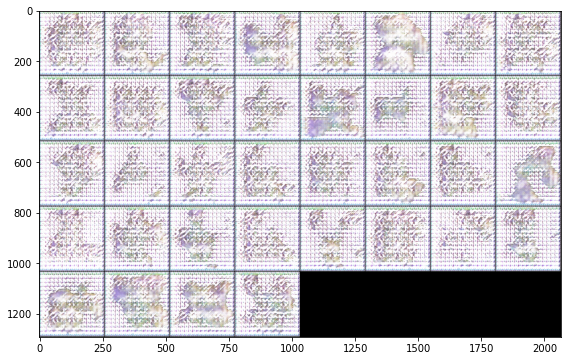



						***** EPOCH [35/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.001 Generator Loss: 0.009


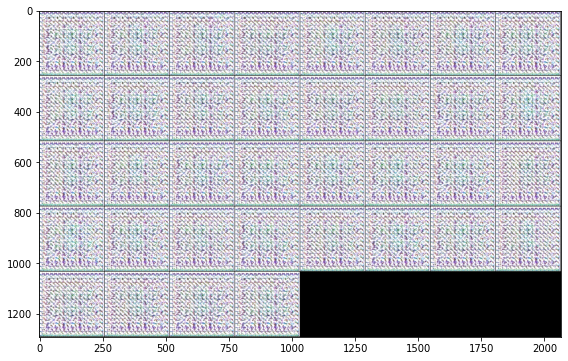



						***** EPOCH [36/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.005 Generator Loss: 0.011


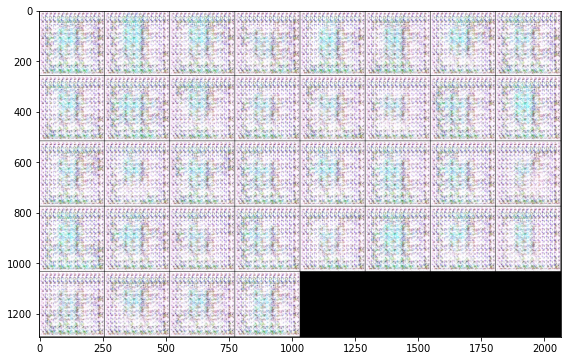



						***** EPOCH [37/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.013 Generator Loss: 0.006


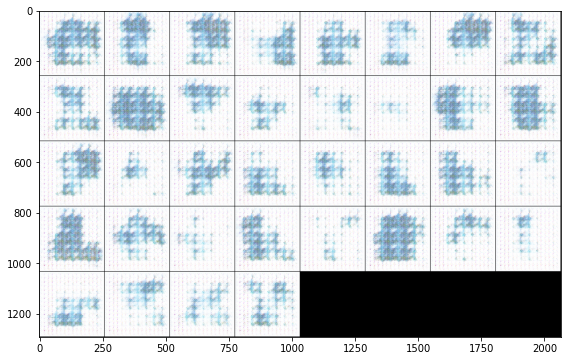



						***** EPOCH [38/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.018 Generator Loss: 0.006


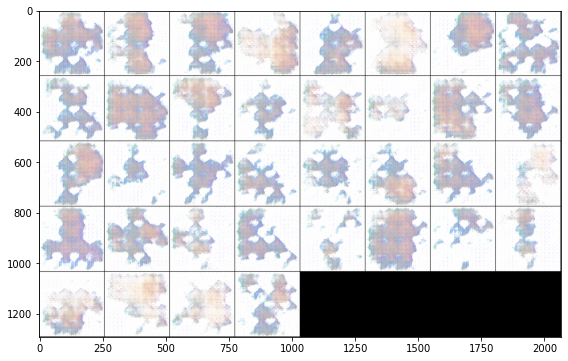



						***** EPOCH [39/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.012 Generator Loss: 0.008


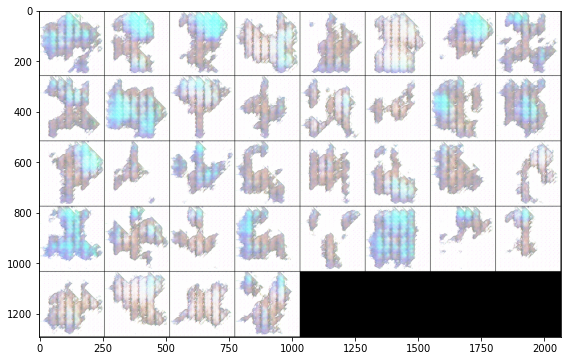



						***** EPOCH [40/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.016 Generator Loss: 0.007


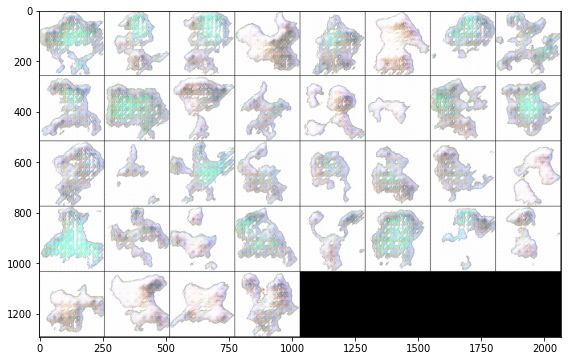



						***** EPOCH [41/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.012 Generator Loss: 0.003


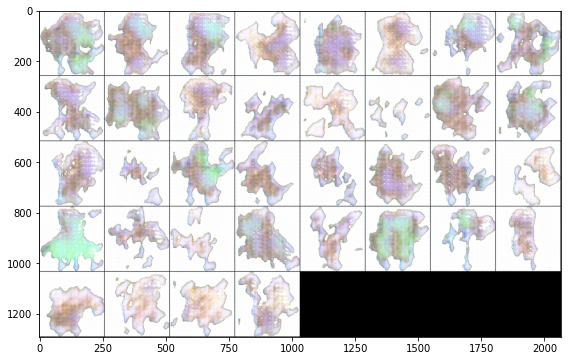



						***** EPOCH [42/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.012 Generator Loss: 0.000


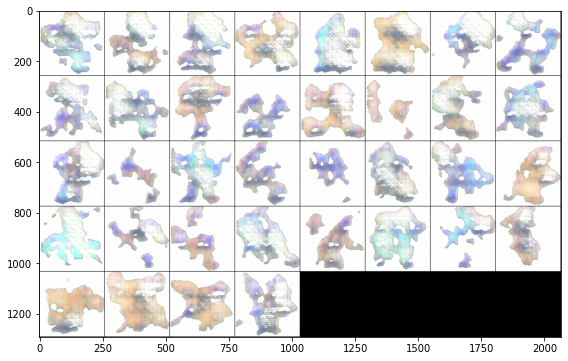



						***** EPOCH [43/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.013 Generator Loss: 0.001


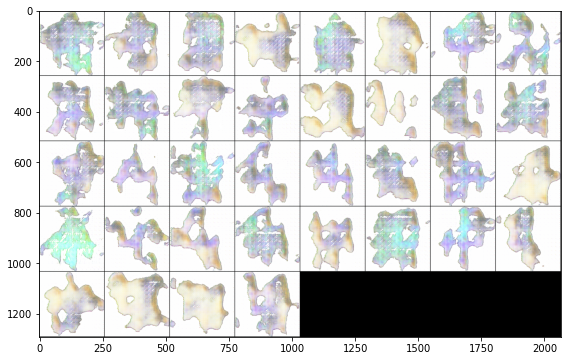



						***** EPOCH [44/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.007 Generator Loss: 0.001


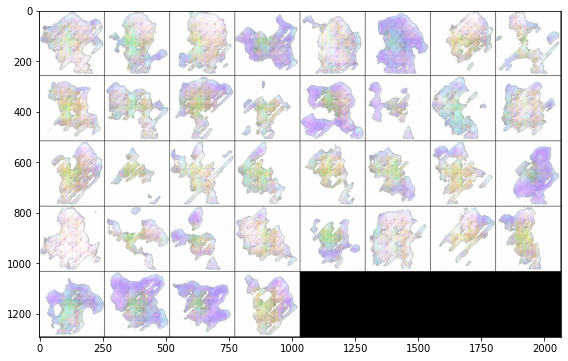



						***** EPOCH [45/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.008 Generator Loss: 0.003


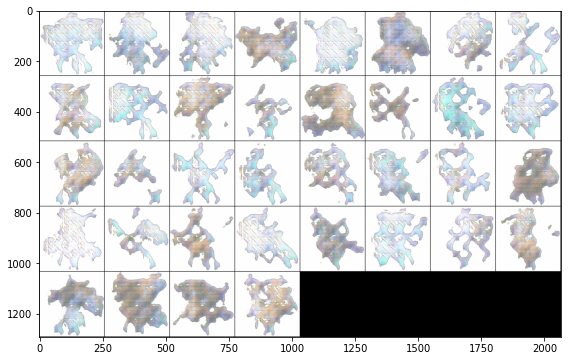



						***** EPOCH [46/100] *****


100%|██████████| 52/52 [00:33<00:00,  1.58it/s]


Discriminant Loss: 0.006 Generator Loss: 0.009


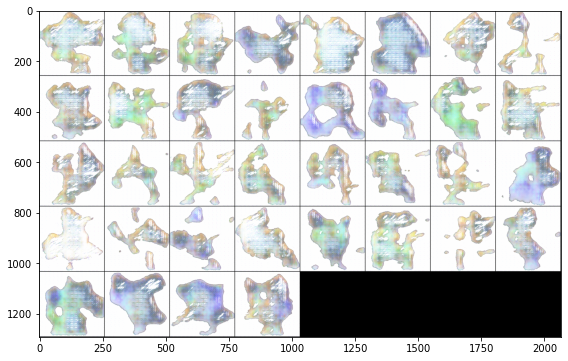



						***** EPOCH [47/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.003 Generator Loss: 0.004


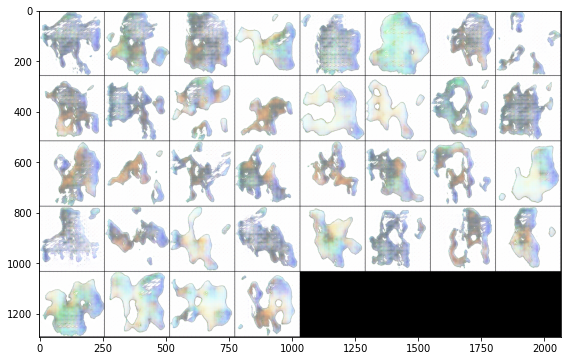



						***** EPOCH [48/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.010 Generator Loss: 0.000


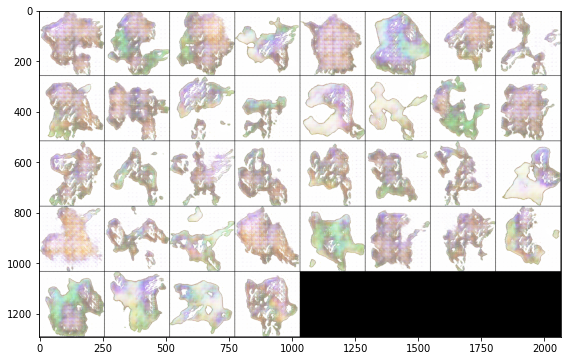



						***** EPOCH [49/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.015 Generator Loss: 0.002


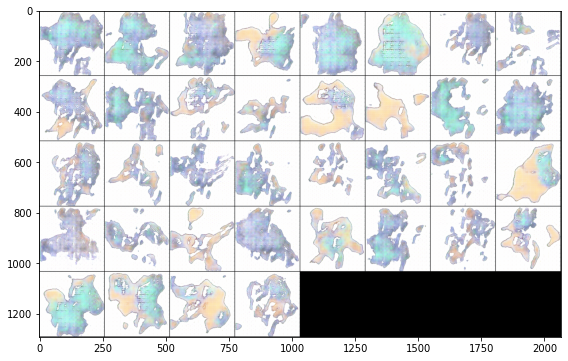



						***** EPOCH [50/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.009 Generator Loss: 0.003


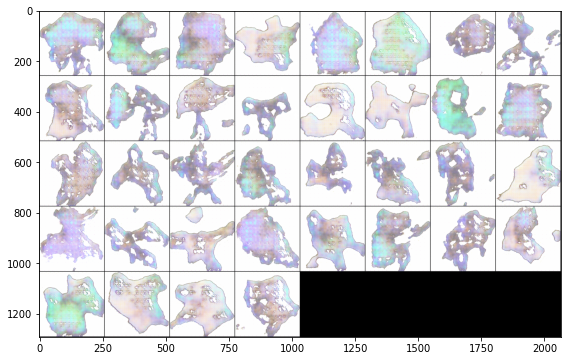



						***** EPOCH [51/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.005 Generator Loss: 0.008


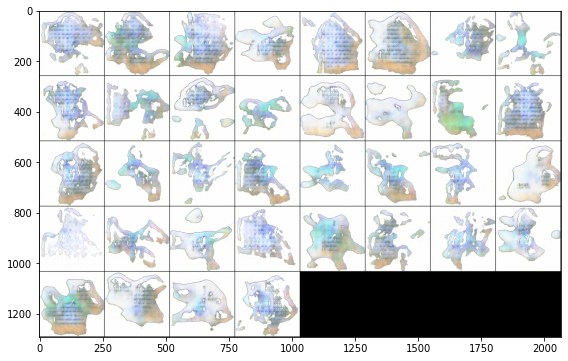



						***** EPOCH [52/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.005 Generator Loss: 0.011


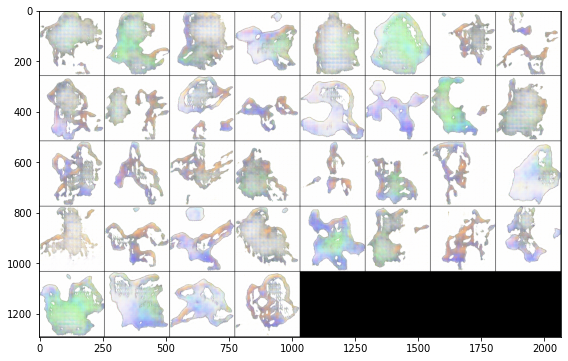



						***** EPOCH [53/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.003 Generator Loss: 0.008


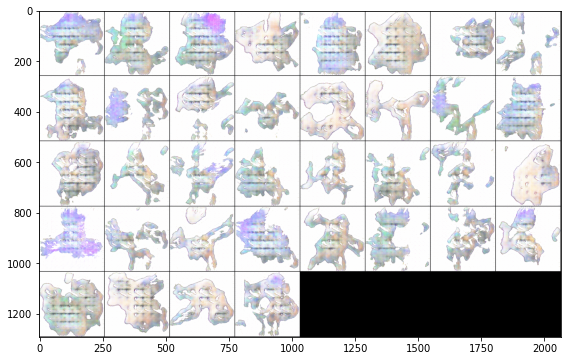



						***** EPOCH [54/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.006 Generator Loss: 0.007


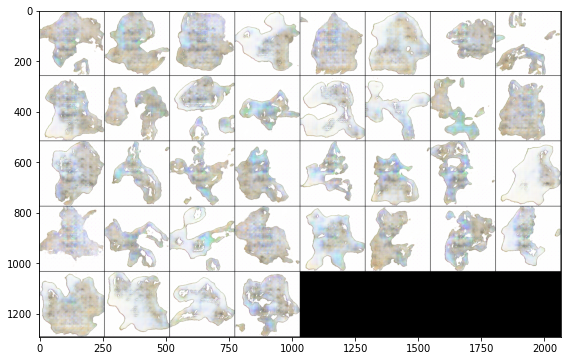



						***** EPOCH [55/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.003 Generator Loss: 0.007


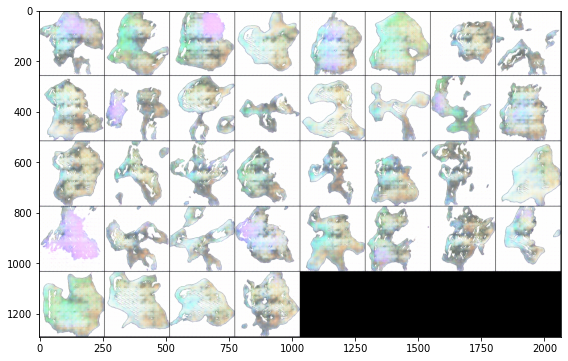



						***** EPOCH [56/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.002 Generator Loss: 0.000


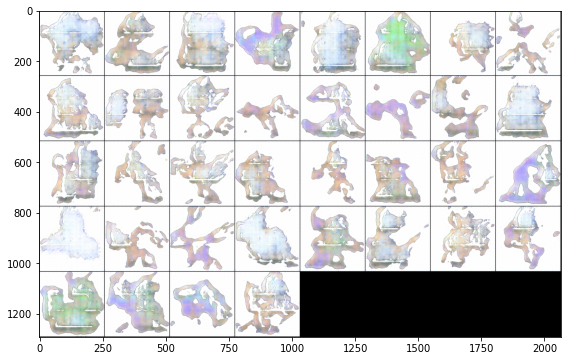



						***** EPOCH [57/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.011 Generator Loss: 0.005


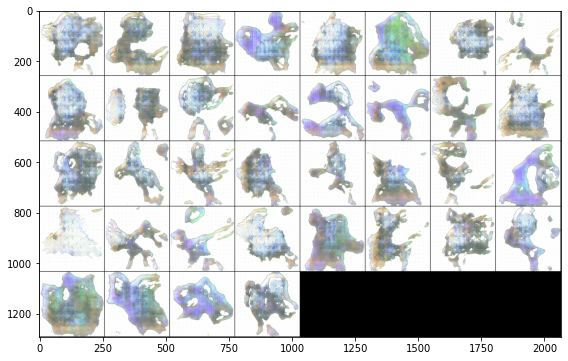



						***** EPOCH [58/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.004 Generator Loss: 0.001


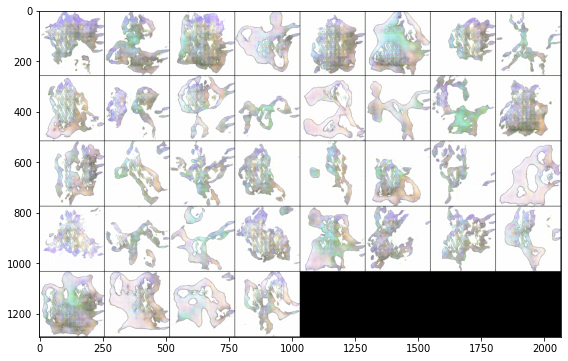



						***** EPOCH [59/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.005 Generator Loss: 0.003


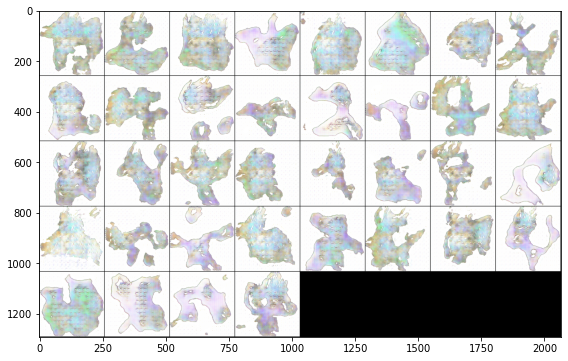



						***** EPOCH [60/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.003 Generator Loss: 0.006


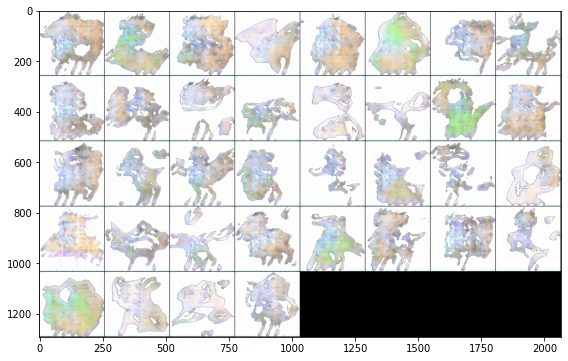



						***** EPOCH [61/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.003 Generator Loss: 0.004


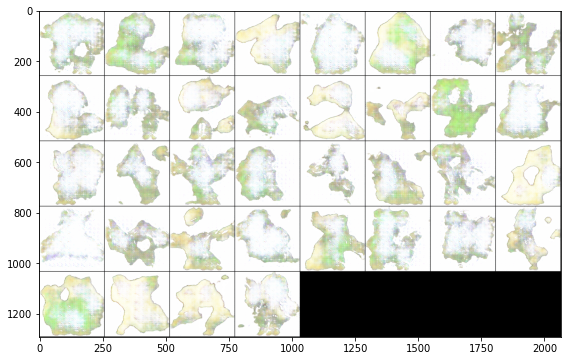



						***** EPOCH [62/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.005 Generator Loss: 0.010


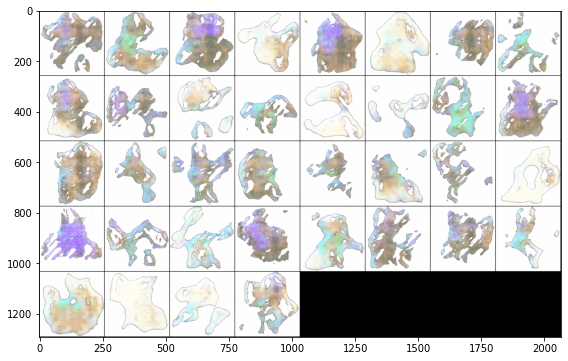



						***** EPOCH [63/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.003 Generator Loss: 0.007


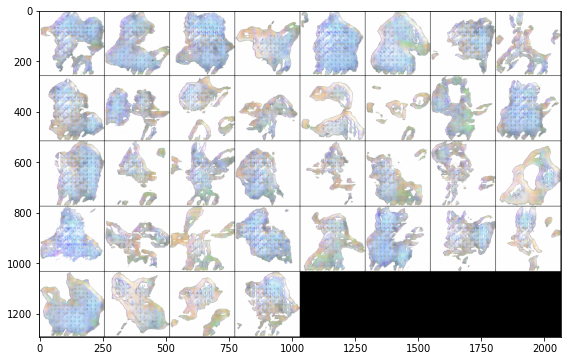



						***** EPOCH [64/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.001 Generator Loss: 0.006


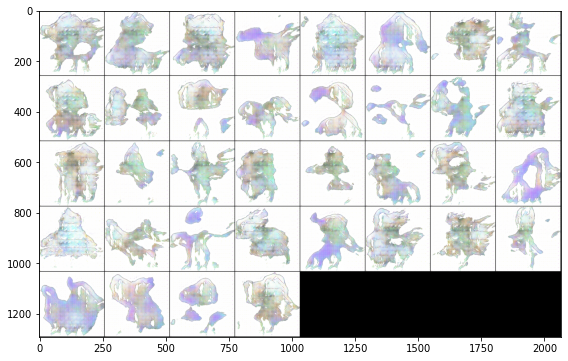



						***** EPOCH [65/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.011 Generator Loss: 0.014


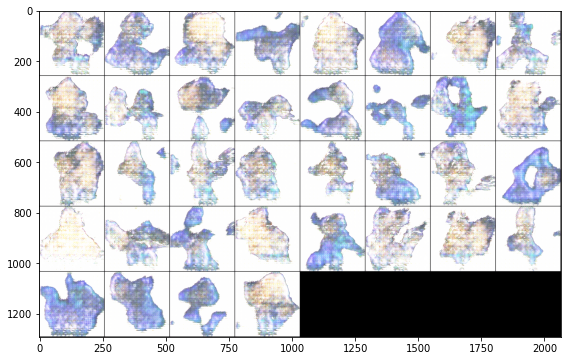



						***** EPOCH [66/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.006 Generator Loss: 0.008


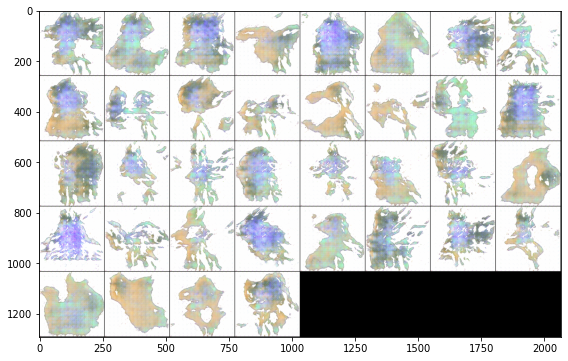



						***** EPOCH [67/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.003 Generator Loss: 0.002


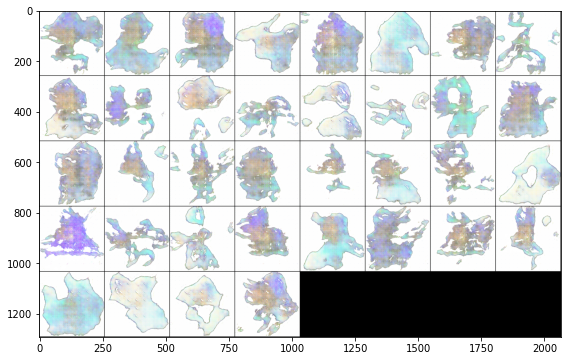



						***** EPOCH [68/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.003 Generator Loss: 0.001


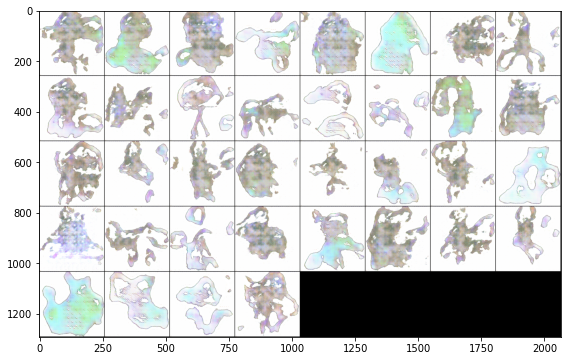



						***** EPOCH [69/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.005 Generator Loss: 0.000


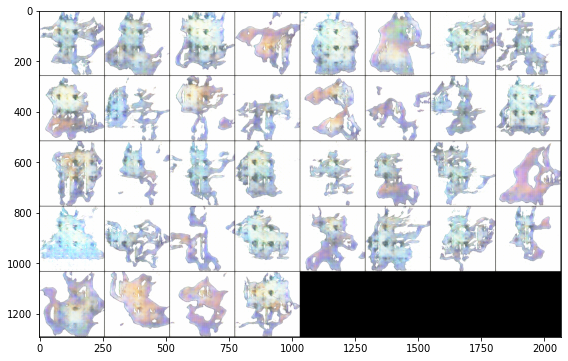



						***** EPOCH [70/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.009 Generator Loss: 0.007


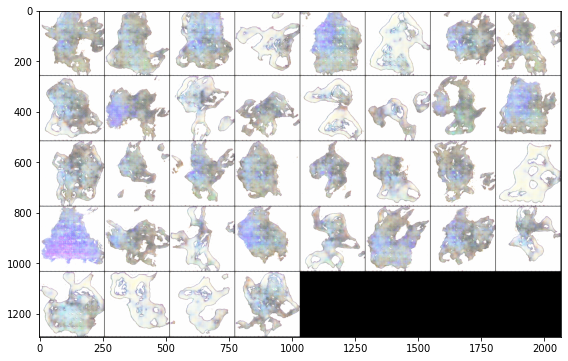



						***** EPOCH [71/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.003 Generator Loss: 0.007


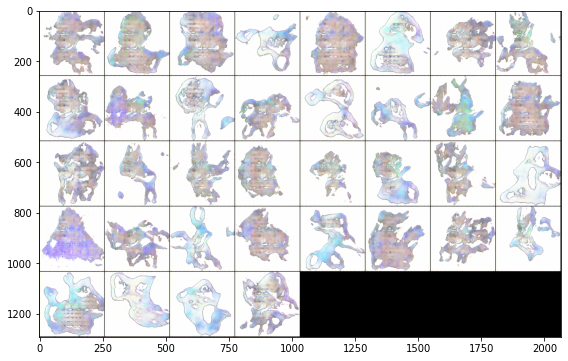



						***** EPOCH [72/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.002 Generator Loss: 0.016


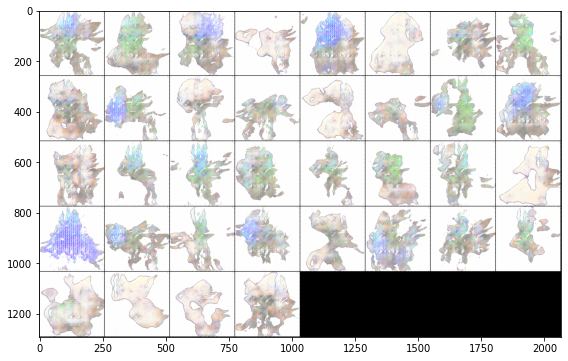



						***** EPOCH [73/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.001 Generator Loss: 0.011


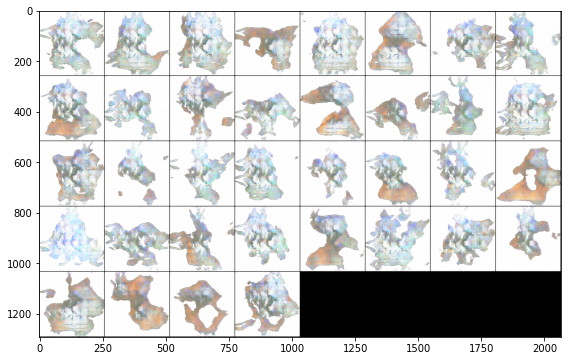



						***** EPOCH [74/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.001 Generator Loss: 0.008


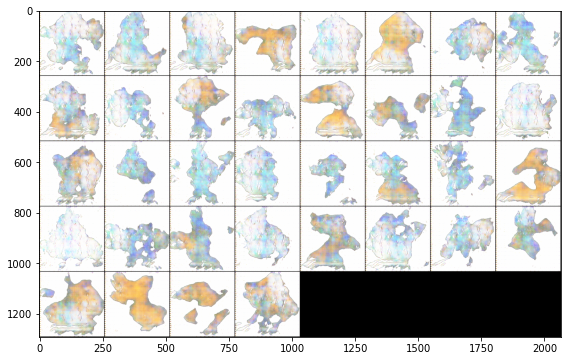



						***** EPOCH [75/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.001 Generator Loss: 0.010


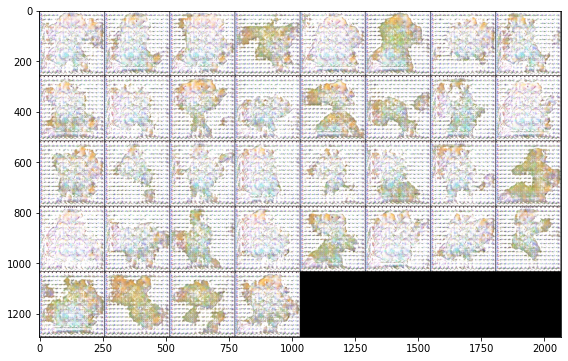



						***** EPOCH [76/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.001 Generator Loss: 0.010


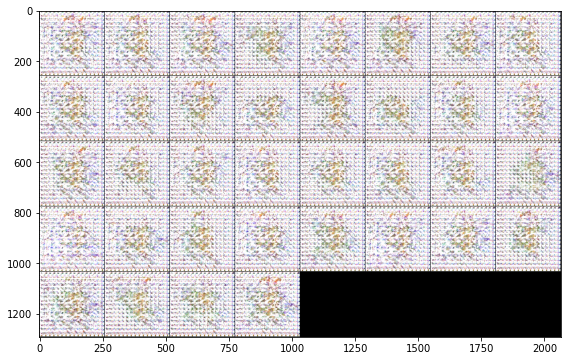



						***** EPOCH [77/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.000 Generator Loss: 0.010


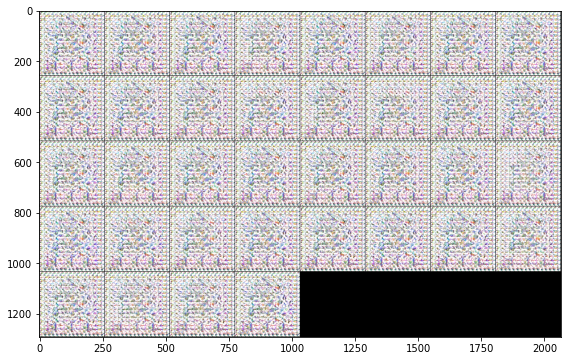



						***** EPOCH [78/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.000 Generator Loss: 0.011


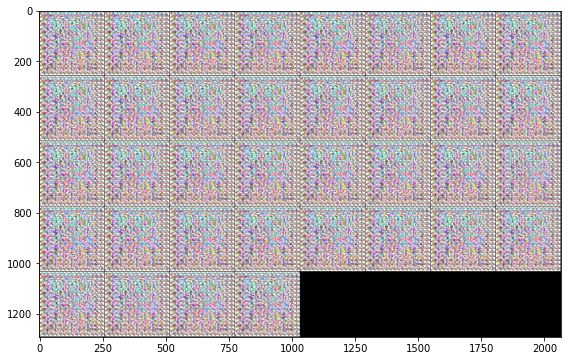



						***** EPOCH [79/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.000 Generator Loss: 0.010


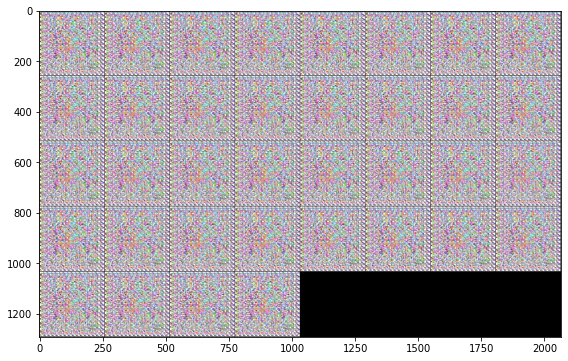



						***** EPOCH [80/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.000 Generator Loss: 0.008


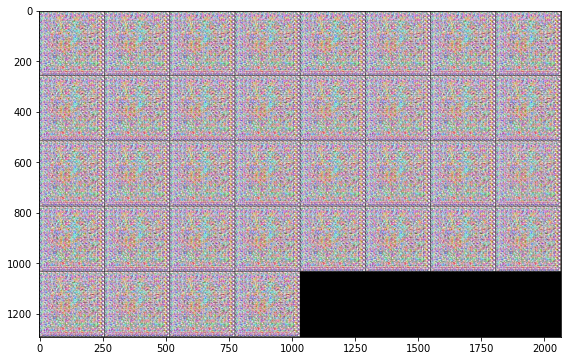



						***** EPOCH [81/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.008 Generator Loss: 0.018


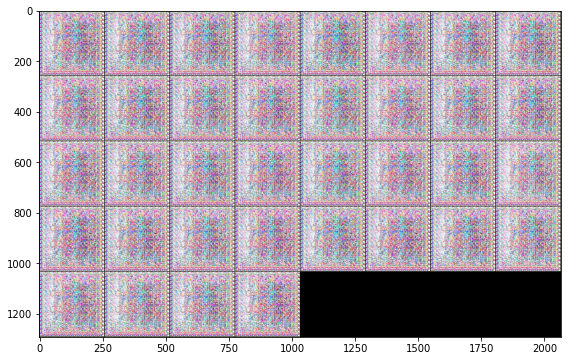



						***** EPOCH [82/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.014 Generator Loss: 0.011


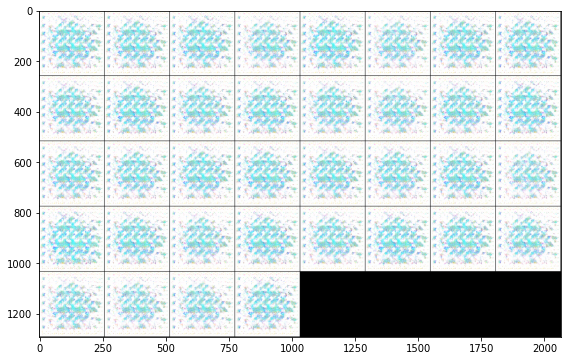



						***** EPOCH [83/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.016 Generator Loss: 0.001


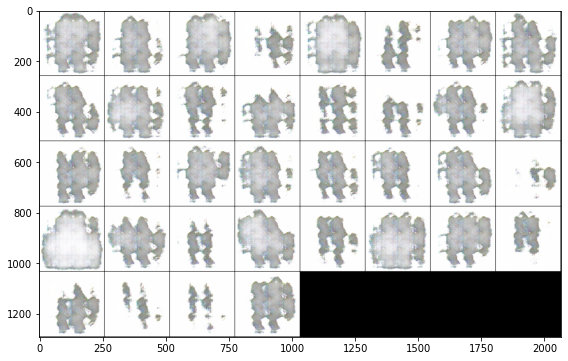



						***** EPOCH [84/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.008 Generator Loss: 0.012


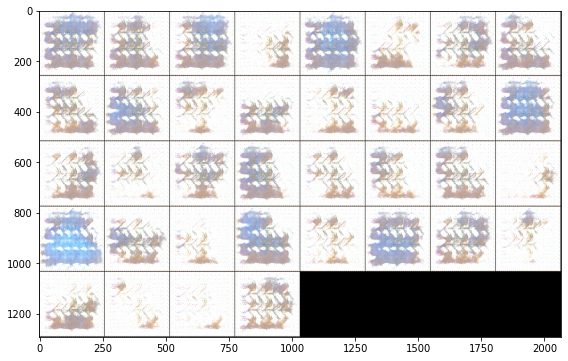



						***** EPOCH [85/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.002 Generator Loss: 0.001


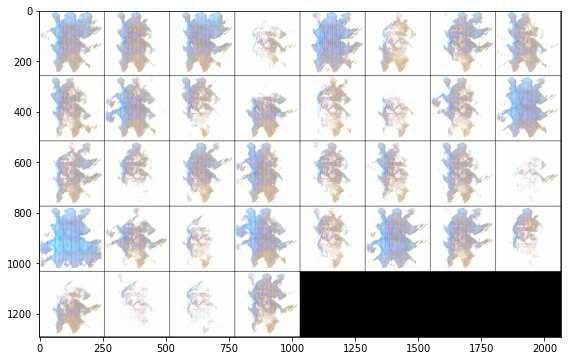



						***** EPOCH [86/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.011 Generator Loss: 0.008


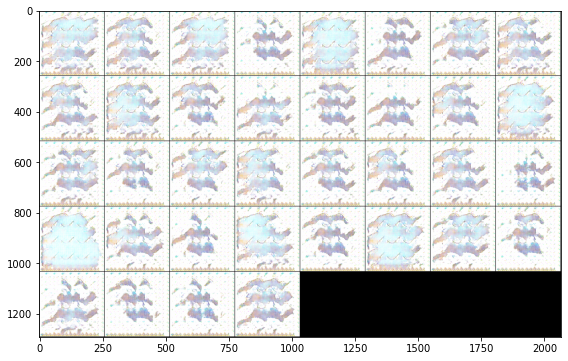



						***** EPOCH [87/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.006 Generator Loss: 0.007


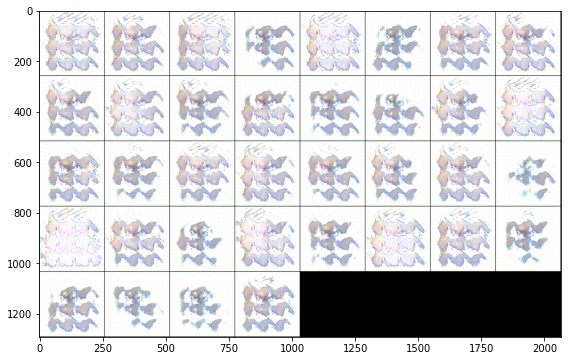



						***** EPOCH [88/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.001 Generator Loss: 0.008


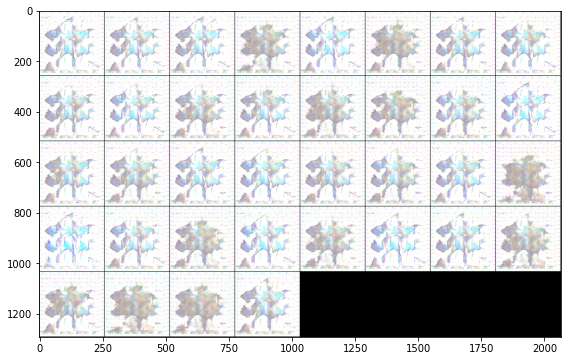



						***** EPOCH [89/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.001 Generator Loss: 0.008


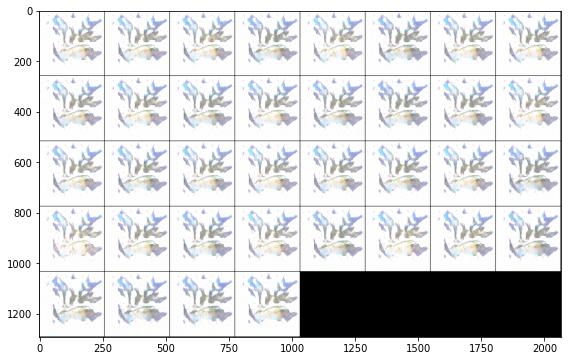



						***** EPOCH [90/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.000 Generator Loss: 0.009


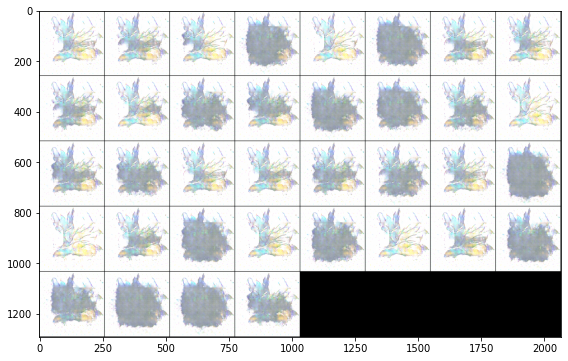



						***** EPOCH [91/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.016 Generator Loss: 0.013


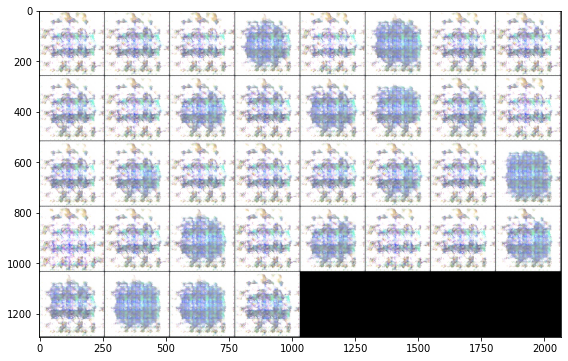



						***** EPOCH [92/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.001 Generator Loss: 0.008


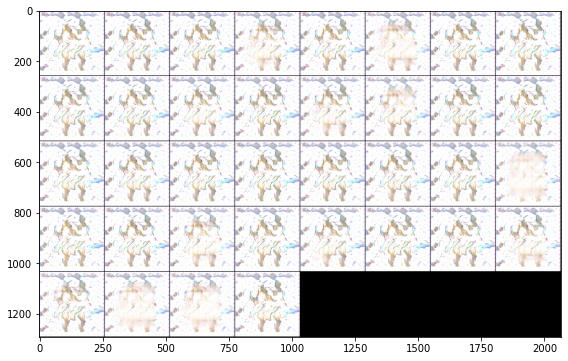



						***** EPOCH [93/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.001 Generator Loss: 0.000


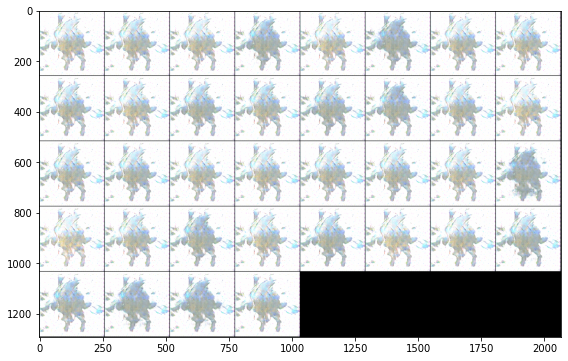



						***** EPOCH [94/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.009 Generator Loss: 0.013


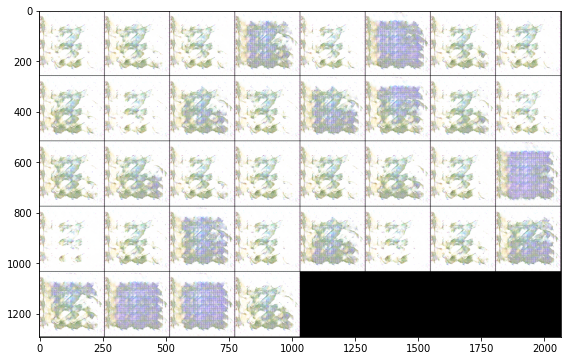



						***** EPOCH [95/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.022 Generator Loss: 0.001


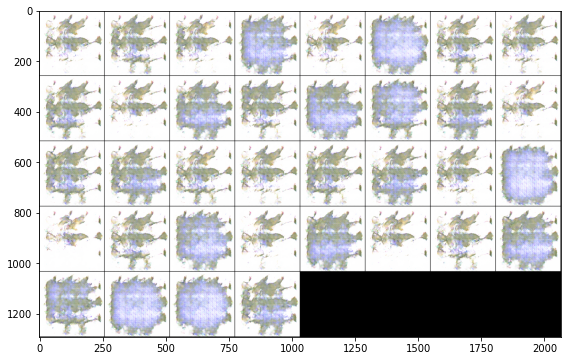



						***** EPOCH [96/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.004 Generator Loss: 0.007


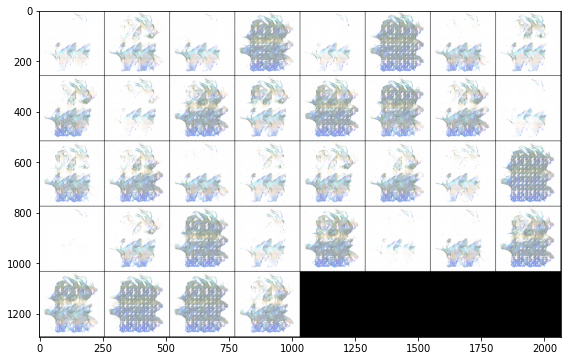



						***** EPOCH [97/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.001 Generator Loss: 0.002


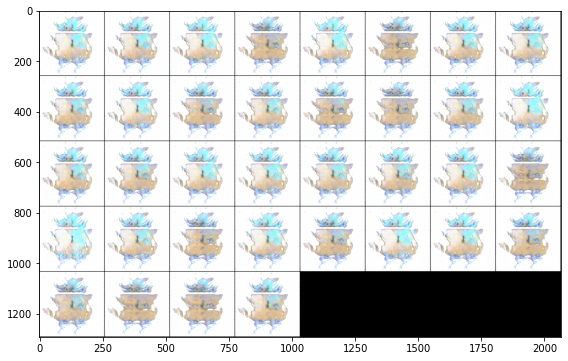



						***** EPOCH [98/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


Discriminant Loss: 0.002 Generator Loss: 0.001


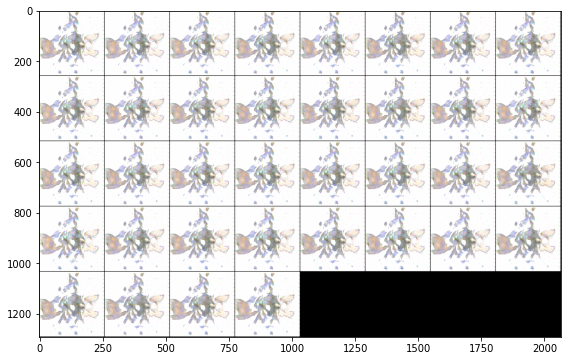



						***** EPOCH [99/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.003 Generator Loss: 0.007


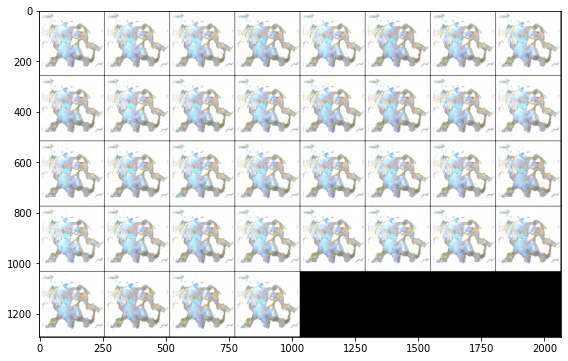



						***** EPOCH [100/100] *****


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


Discriminant Loss: 0.001 Generator Loss: 0.002


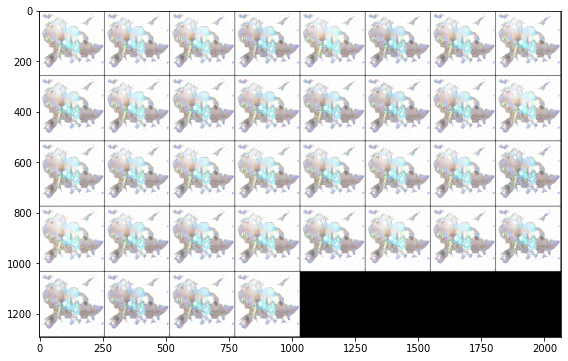

In [13]:
gen.train()
disc.train()

for epoch in range(NUM_EPOCHS):
    print(f'\t\t\t\t\t\t***** EPOCH [{epoch+1}/{NUM_EPOCHS}] *****')
    gen_loss = 0
    disc_loss = 0
    samples = 0
    for (real, _) in tqdm(dataloader):
        # real_labels are all equal to 1
        real = real.to(DEVICE)
        noise = torch.randn(BATCH_SIZE, Z_DIM, 1, 1).to(DEVICE)
        
        # Generate Fake Images
        fake = gen.forward(noise)
        
        ### TRAIN DISCRIMINATOR ###
        pred_disc  = disc.forward(real)
        loss_disc_real = criterion(pred_disc, torch.ones_like(pred_disc).to(DEVICE))
        pred_disc  = disc.forward(fake)
        loss_disc_fake = criterion(pred_disc, torch.zeros_like(pred_disc).to(DEVICE))
        loss_disc = (loss_disc_real + loss_disc_fake) / 2
        opt_disc.zero_grad()
        loss_disc.backward(retain_graph=True)
        opt_disc.step()
        
        ### TRAIN GENERATOR ###
        pred_gen = disc(fake)
        loss_gen = criterion(pred_gen, torch.ones_like(pred_gen).to(DEVICE))
        opt_gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()
    
        gen_loss += loss_gen.item()
        disc_loss += loss_disc.item()
        samples += len(real)
        
    print(f'Discriminant Loss: {disc_loss/samples:.3f} Generator Loss: {loss_gen/samples:.3f}')
    
    pred = gen.forward(fixed_noise)
    img_grid = torchvision.utils.make_grid(pred, normalize=True)
    plt.figure(figsize=(12, 6))
    plt.imshow(img_grid.permute([1, 2, 0]).cpu().detach())
    plt.show()
    print(f'\n')

It's pretty obvious that the learning was not that stable. This can probably be solved with Wasserstein GANs. We'll try to do it the next notebook.

If you have read this... You better upvote it! (JK if you liked it please do consider upvoting!!)

Thanks for viewing!